In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import numpy as np
from collections import Counter
import re
import string
import os
from os import path
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [3]:
# load raw fake news dataset
df = pd.read_csv("raw fake news dataset.csv")

In [4]:
# clean dataset
# remove data that has >280 characters and <15 characters
df = df[df["content"].str.len() <=280]
df = df[df["content"].str.len() >15]

# remove special characters
from nltk.corpus import stopwords as nltkstopwords
stops = set(nltkstopwords.words("english"))
def cleantext(string):
    text = string.lower().split()
    text = " ".join(text)
    text = re.sub(r"http(\S)+",' ',text)    
    text = re.sub(r"www(\S)+",' ',text)
    text = re.sub(r"&",' and ',text)  
    tx = text.replace('&amp',' ')
    text = re.sub(r"[^0-9a-zA-Z]+",' ',text)
    text = text.split()
    text = [w for w in text if not w in stops]
    text = " ".join(text)
    return text

df["content"] = df["content"].apply(cleantext)

shuffledDf = df.sample(frac=1).reset_index(drop=True)
shuffledDf.head(10)

,content,label
0,ndtvtownhall dr siddharth mukherjee drsidmukhe...,1
1,ny continues fight pandemic want make sure nye...,0
2,see warnock fella coming disguising moderate p...,0
3,lemon juice bicarbonate mixture prevents cures...,0
4,smokers better protected coronavirus,0
5,viral image differences cold flu covid 19,0
6,one new case covid 19 report new zealand today...,1
7,people ethnic minorities britain dying disprop...,1
8,lockdown read still read page,0
9,indian government started scheme called rashtr...,0


In [5]:
# save cleaned fake news dataset
df.to_csv("Fake news dataset.csv")

In [5]:
# define extra stop words
stops = stops.union({'pic','co','com','u','twitter'})

Number of fake news data 11160
Number of real news data 7844


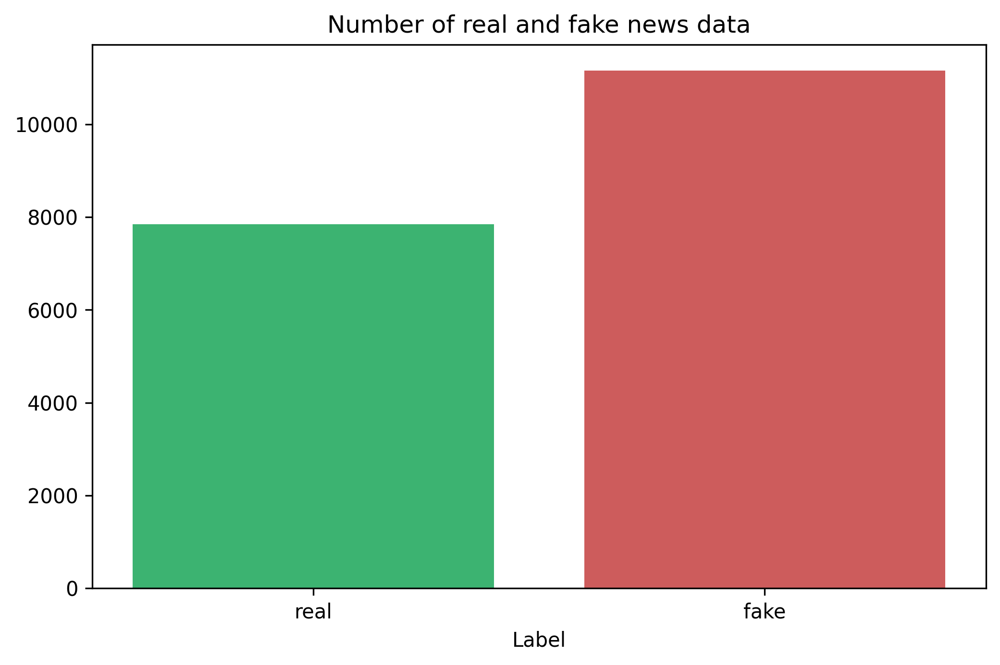

<function matplotlib.pyplot.show(close=None, block=None)>

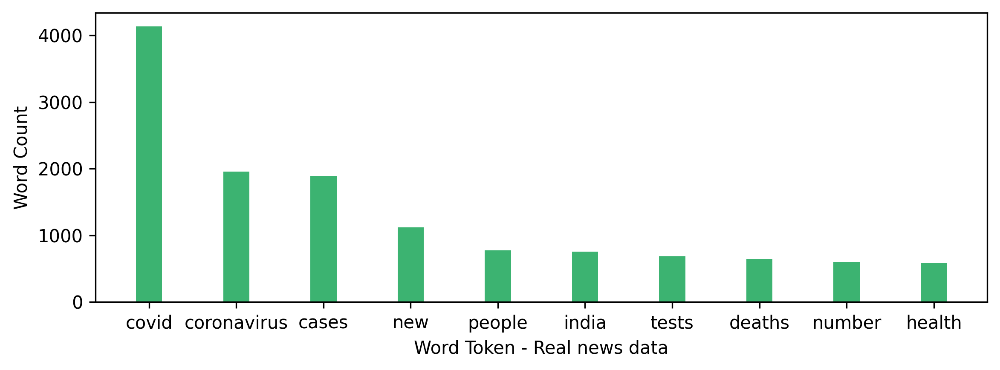

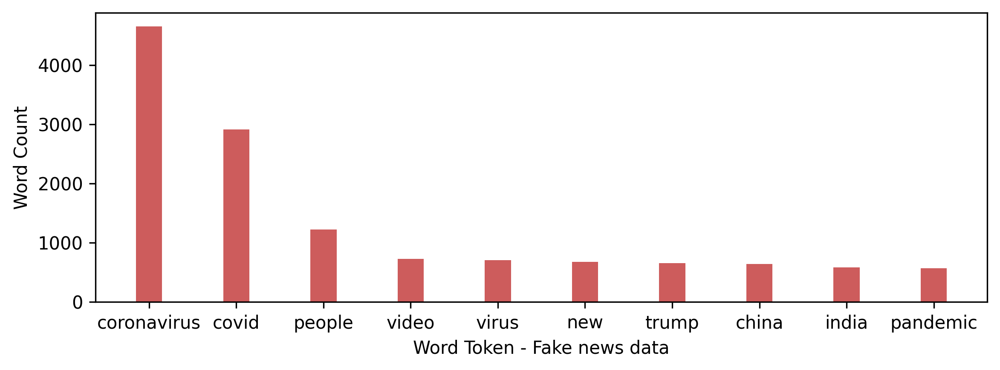

In [6]:
# Analyse Data
allText = df['content']
allTextCombined = ' '.join(allText)

fakeText = df[df.label == 0]
print("Number of fake news data", fakeText.shape[0])
fakeTextCombined = ' '.join(fakeText["content"])

realText = df[df.label == 1]
print("Number of real news data", realText.shape[0])
realTextCombined = ' '.join(realText["content"])

allTokensWords = [w for w in str(allTextCombined).split() if len(w)>1 and w not in stops]
allWordCount = (Counter(allTokensWords).most_common(10))

fakeTokensWords = [w for w in str(fakeTextCombined).split() if len(w)>1 and w not in stops]
fakeWordCount = (Counter(fakeTokensWords).most_common(10))

realTokensWords = [w for w in str(realTextCombined).split() if len(w)>1 and w not in stops]
realWordCount = (Counter(realTokensWords).most_common(10))

plt.figure(figsize=(8,5))
plt.title("Number of real and fake news data")
plt.xlabel("Label")
plt.bar(["real"],[realText.shape[0]],color="mediumseagreen")
plt.bar(["fake"],[fakeText.shape[0]],color="indianred")
plt.show()

ypos = np.arange(10)
plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in realWordCount])
plt.bar(ypos, [i[1] for i in realWordCount], width=0.3, color="mediumseagreen")
plt.xlabel("Word Token - Real news data")
plt.ylabel("Word Count")
plt.show

plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in fakeWordCount])
plt.bar(ypos, [i[1] for i in fakeWordCount], width=0.3, color="indianred")
plt.xlabel("Word Token - Fake news data")
plt.ylabel("Word Count")
plt.show




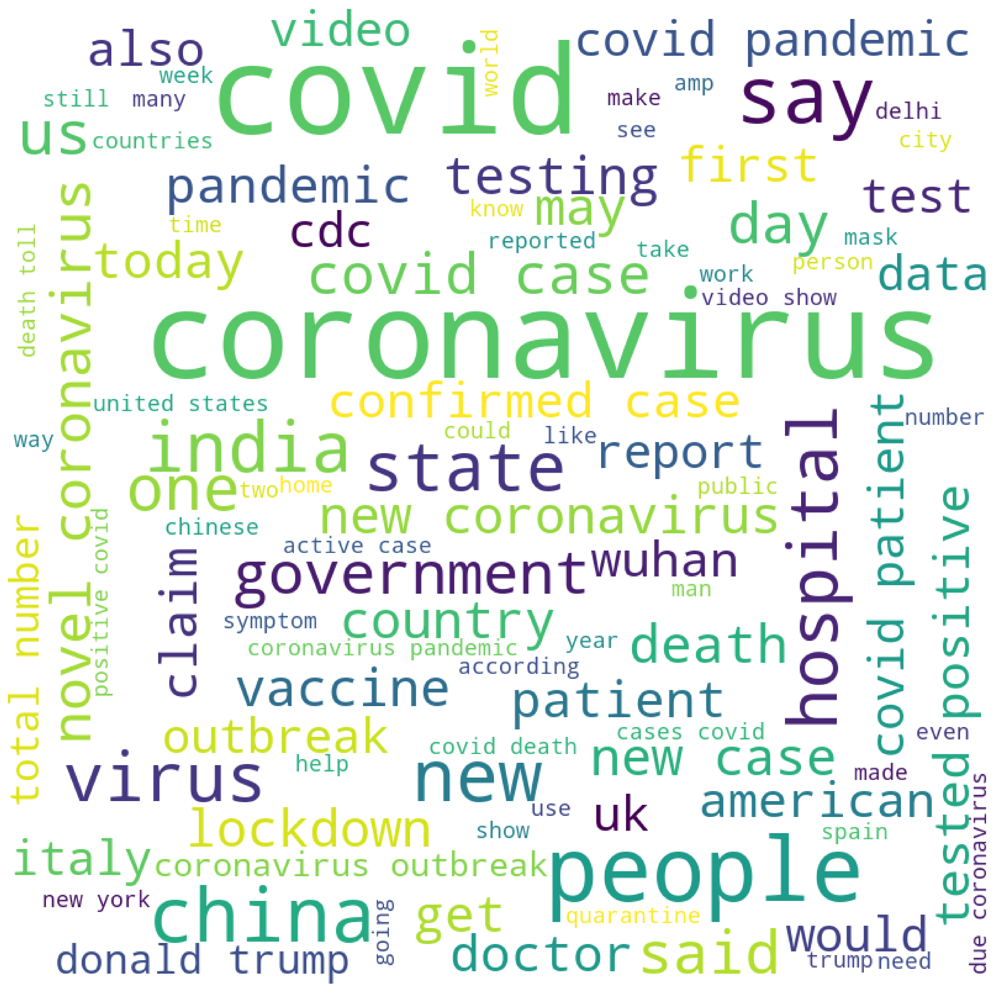

In [8]:
# wordcloud generation of dataset
wordcloud1 = WordCloud(background_color="white", max_words = 100 , width = 800 , height = 800,
               stopwords=stops, max_font_size=100, random_state=42).generate(str(allTextCombined))
plt.figure(figsize=(20,20))
plt.imshow(wordcloud1)
plt.axis("off")
plt.show()

(-0.5, 3029.5, 1090.5, -0.5)

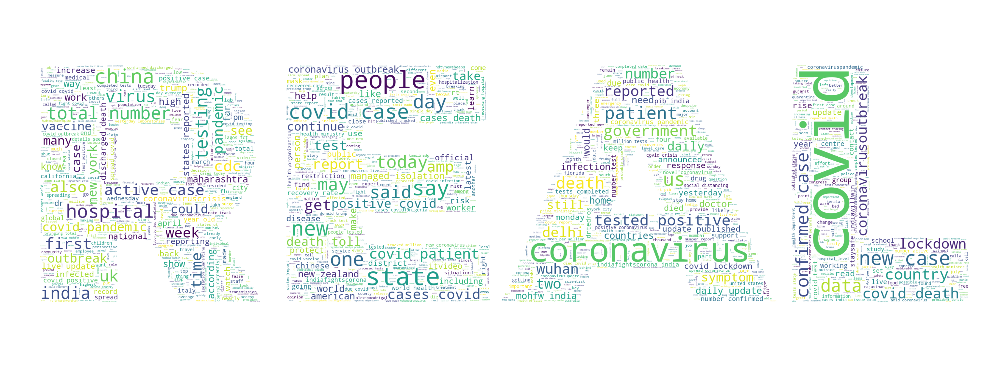

In [11]:
# real news class word cloud with masking

corpus_str = str(realTextCombined)

d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()

# read the mask / color image taken from
coloring = np.array(Image.open(path.join(d, "real_news.jpg")))

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800, mask=coloring,
               stopwords=stops, max_font_size=200, random_state=42)

# generate word cloud
wc.generate(corpus_str)

# create coloring from image
image_colors = ImageColorGenerator(coloring)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


(-0.5, 799.5, 799.5, -0.5)

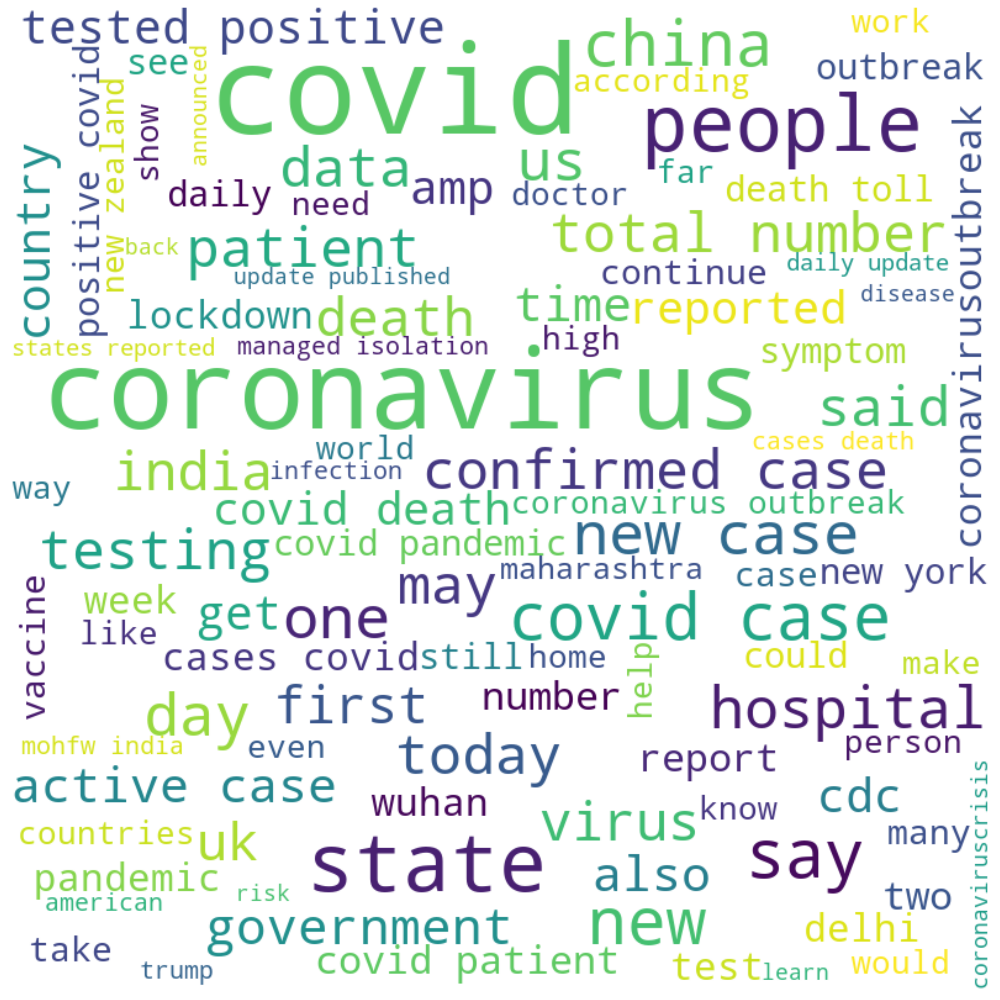

In [15]:
# real word cloud without masking

corpus_str = str(realTextCombined)

wc = WordCloud(background_color="white", max_words = 100 , width = 800 , height = 800,
               stopwords=stops, max_font_size=100, random_state=42)

# generate word cloud
wc.generate(corpus_str)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


(-0.5, 3029.5, 1090.5, -0.5)

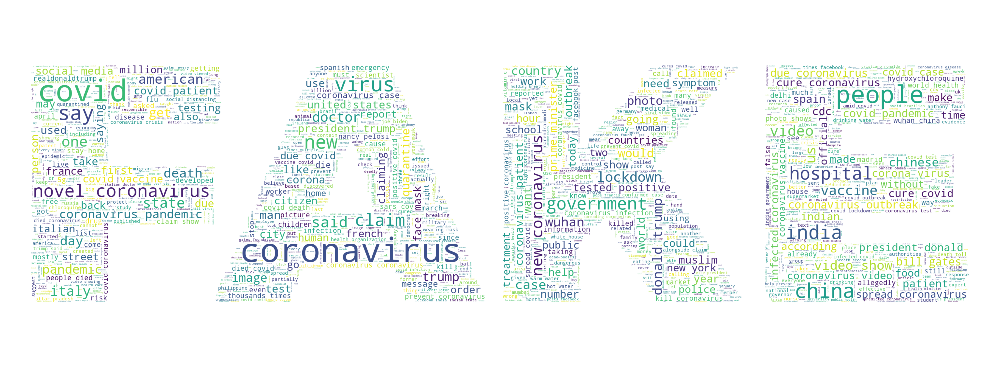

In [12]:
# fake news class word cloud with masking

corpus_str = str(fakeTextCombined)

d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()

# read the mask / color image taken from
coloring = np.array(Image.open(path.join(d, "fake_news.jpg")))

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800, mask=coloring,
               stopwords=stops, max_font_size=200, random_state=42)

# generate word cloud
wc.generate(corpus_str)

# create coloring from image
image_colors = ImageColorGenerator(coloring)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


(-0.5, 799.5, 799.5, -0.5)

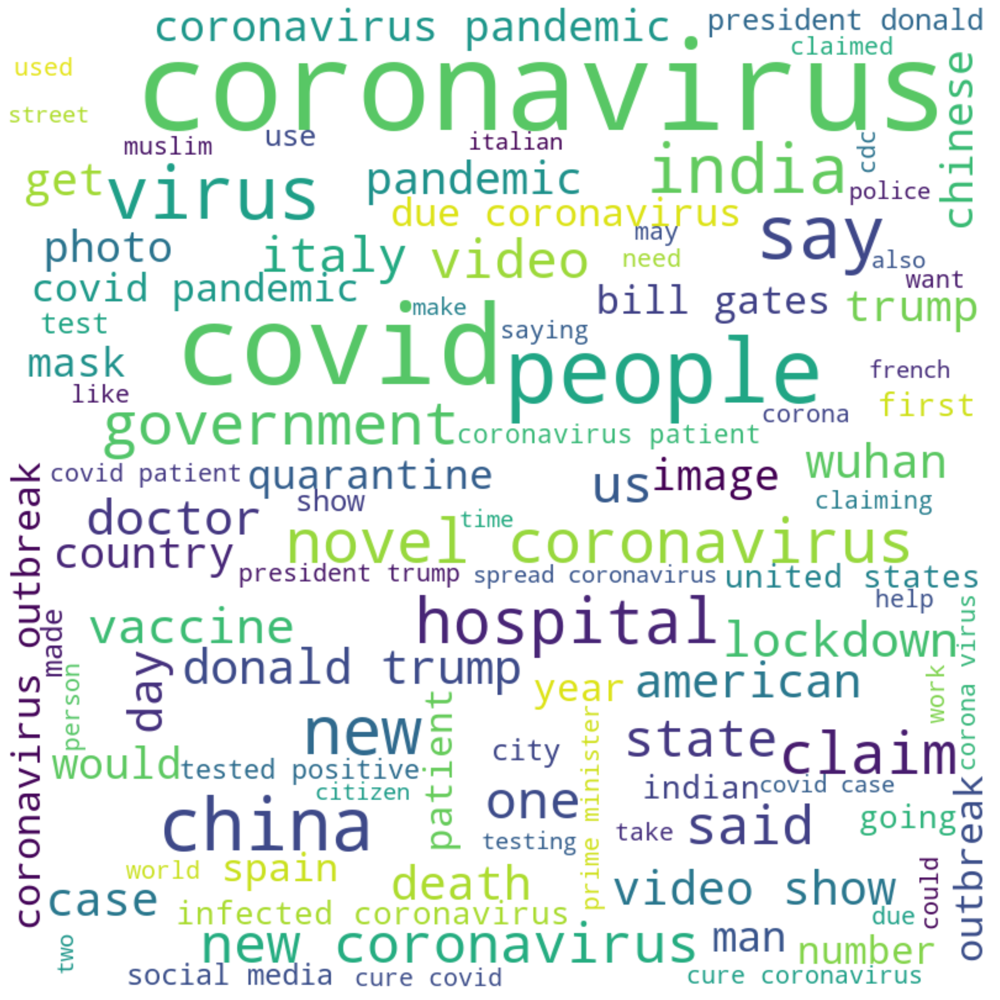

In [17]:
# fake news class word cloud with masking

corpus_str = str(fakeTextCombined)

wc = WordCloud(background_color="white", max_words = 100 , width = 800 , height = 800,
               stopwords=stops, max_font_size=100, random_state=42)

# generate word cloud
wc.generate(corpus_str)

plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


